# Прекод

# Сборный проект-4

Вам поручено разработать демонстрационную версию поиска изображений по запросу.

Для демонстрационной версии нужно обучить модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — покажет, насколько текст и картинка подходят друг другу.

### Описание данных

Данные лежат в папке `/datasets/image_search/` или доступны по [ссылке](https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip).

В файле `train_dataset.csv` находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `train_images` содержатся изображения для тренировки модели.

В файле `CrowdAnnotations.tsv` — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.
3. Доля людей, подтвердивших, что описание соответствует изображению.
4. Количество человек, подтвердивших, что описание соответствует изображению.
5. Количество человек, подтвердивших, что описание не соответствует изображению.

В файле `ExpertAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.

3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

В файле `test_queries.csv` находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `test_images` содержатся изображения для тестирования модели.

In [1]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
import numpy as np

from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, Flatten, Dense, AveragePooling2D, MaxPooling2D, GlobalAveragePooling2D,  AvgPool2D, Dropout
from tensorflow import keras

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import ResNet50

import random
import time


from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.metrics import mean_squared_error, accuracy_score, recall_score, r2_score, precision_score, confusion_matrix, f1_score, mean_absolute_error
from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.linear_model import LinearRegression
from sklearn.feature_extraction.text import TfidfVectorizer

import torch
import torch.nn as nn
import re
import nltk

from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from PIL import Image
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from sklearn.model_selection import GroupShuffleSplit

import torchvision
import torchvision.models as models

from functools import lru_cache

In [2]:
pd.set_option('display.float_format', '{:.2f}'.format)


pd.set_option('display.max_rows', None)

pd.set_option('display.max_columns', None)

pd.set_option('display.max_colwidth', None)

## Исследовательский анализ данных

Наш датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи вы должны эти оценки агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

Вы можете воспользоваться другим методом агрегации оценок или придумать свой.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:

1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

После анализа экспертных и краудсорсинговых оценок выберите либо одну из них, либо объедините их в одну по какому-то критерию: например, оценка эксперта принимается с коэффициентом 0.6, а крауда — с коэффициентом 0.4.

Ваша модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.


### train_dataset

* В файле train_dataset.csv находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.
* В папке train_images содержатся изображения для тренировки модели.

In [3]:
path_train_dataset = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/train_dataset.csv'
path_train_images = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/train_images/'
path_CrowdAnnotations = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/CrowdAnnotations.tsv'
path_ExpertAnnotations = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/ExpertAnnotations.tsv'
path_test_queries = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/test_queries.csv'
path_test_images_csv = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/test_images.csv'
path_test_images = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/test_images/'

In [4]:
train_dataset = pd.read_csv(path_train_dataset) 
display(train_dataset.head())
train_dataset.info()

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [5]:
len(train_dataset['image'].unique())

1000

In [6]:
len(train_dataset['query_id'].unique())

977

In [7]:
train_im = list(train_dataset['image'].head(15))
train_im

['1056338697_4f7d7ce270.jpg',
 '1262583859_653f1469a9.jpg',
 '2447284966_d6bbdb4b6e.jpg',
 '2549968784_39bfbe44f9.jpg',
 '2621415349_ef1a7e73be.jpg',
 '3030566410_393c36a6c5.jpg',
 '3155451946_c0862c70cb.jpg',
 '3222041930_f642f49d28.jpg',
 '343218198_1ca90e0734.jpg',
 '3718964174_cb2dc1615e.jpg',
 '3741827382_71e93298d0.jpg',
 '486712504_36be449055.jpg',
 '1056338697_4f7d7ce270.jpg',
 '1167669558_87a8a467d6.jpg',
 '2616643090_4f2d2d1a44.jpg']

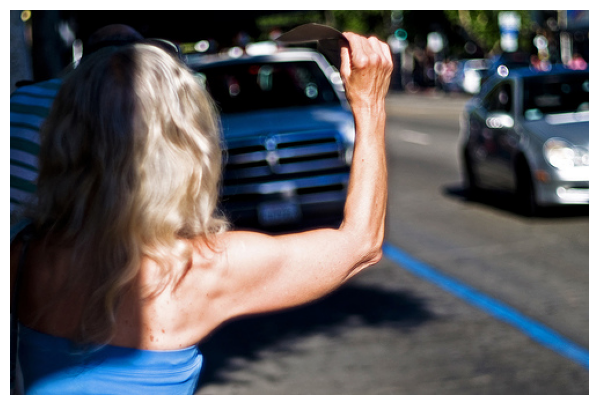

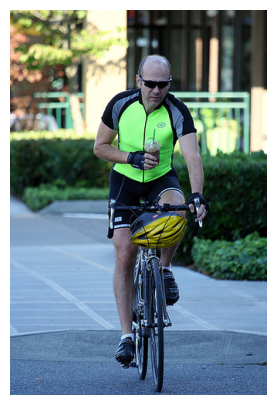

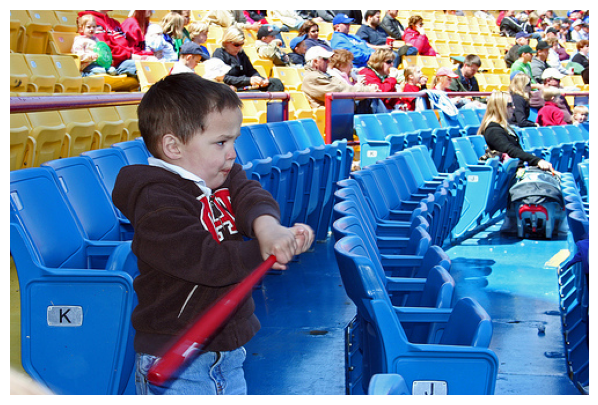

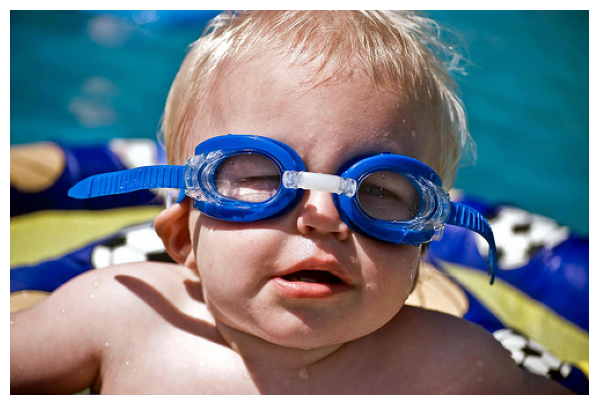

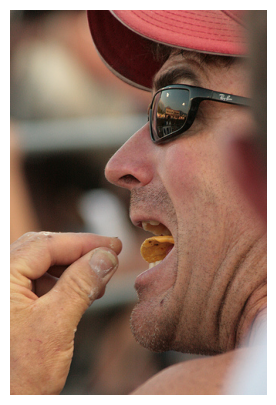

...

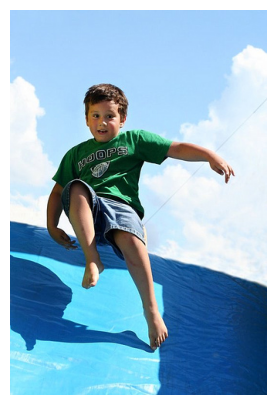

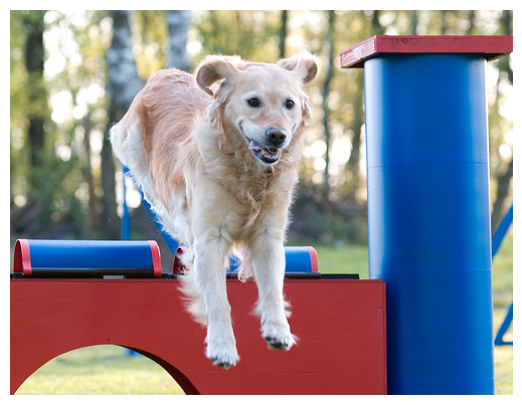

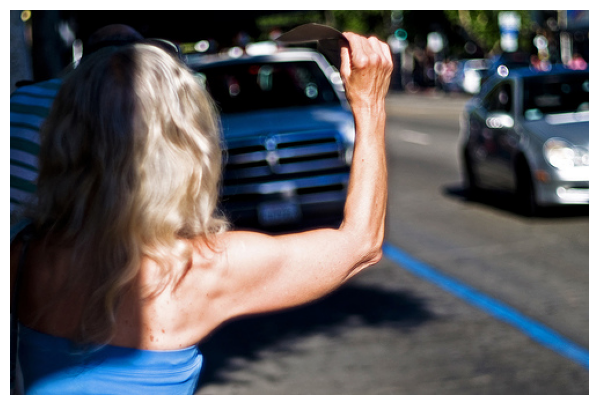

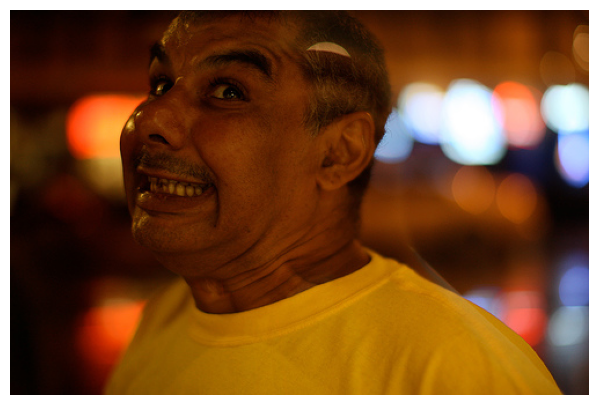

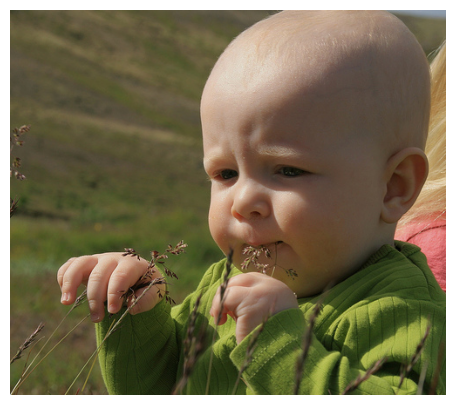

In [8]:
for i in train_im:
    train_box = plt.figure(figsize=(10,5))
    im = Image.open(path_train_images + i)
    train_box.add_subplot()
    plt.axis('off')
    plt.imshow(np.array(im))
    plt.show()

### CrowdAnnotations

* В файле CrowdAnnotations.tsv  — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:
* Имя файла изображения.
* Идентификатор описания.
* Доля людей, подтвердивших, что описание соответствует изображению.
* Количество человек, подтвердивших, что описание соответствует изображению.
* Количество человек, подтвердивших, что описание не соответствует изображению.

In [9]:
sep='\t'

In [10]:
CrowdAnnotations = pd.read_csv(path_CrowdAnnotations, sep=sep)
CrowdAnnotations.columns = ['image', 'query_id', 'share_p', 'count_p_plus', 'count_p_minus']
#CrowdAnnotations = CrowdAnnotations.style.set_properties(**{'border': '1px solid black'})
display(CrowdAnnotations.head())
CrowdAnnotations.info()

,image,query_id,share_p,count_p_plus,count_p_minus
0,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.00,0,3
1,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.00,0,3
2,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.00,0,3
3,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.00,0,3
4,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.00,0,3


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47829 entries, 0 to 47828
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   image          47829 non-null  object 
 1   query_id       47829 non-null  object 
 2   share_p        47829 non-null  float64
 3   count_p_plus   47829 non-null  int64  
 4   count_p_minus  47829 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [11]:
CrowdAnnotations['share_p'].describe()

count   47829.00
mean        0.07
std         0.21
min         0.00
25%         0.00
50%         0.00
75%         0.00
max         1.00
Name: share_p, dtype: float64

In [12]:
len(CrowdAnnotations['image'].unique())

1000

In [13]:
len(CrowdAnnotations['query_id'].unique())

1000

In [14]:
display(len(CrowdAnnotations['query_id'].unique()))
CrowdAnnotations['query_id'].value_counts().head()

1000

query_id
249394748_2e4acfbbb5.jpg#2     169
820169182_f5e78d7d19.jpg#2     150
500446858_125702b296.jpg#2     149
2869491449_1041485a6b.jpg#2    143
327415627_6313d32a64.jpg#2     139
Name: count, dtype: int64

### ExpertAnnotations

* В файле ExpertAnnotations.tsv  — данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:
* Имя файла изображения.
* Идентификатор описания.
* 3, 4, 5 — оценки трёх экспертов. 

In [15]:
ExpertAnnotations = pd.read_csv(path_ExpertAnnotations, sep=sep)
ExpertAnnotations.columns = ['image', 'query_id', 'grade_1_e', 'grade_2_e', 'grade_3_e']
#CrowdAnnotations = CrowdAnnotations.style.set_properties(**{'border': '1px solid black'})
display(ExpertAnnotations.head())
ExpertAnnotations.info()

,image,query_id,grade_1_e,grade_2_e,grade_3_e
0,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
1,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
3,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2
4,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5821 entries, 0 to 5820
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   image      5821 non-null   object
 1   query_id   5821 non-null   object
 2   grade_1_e  5821 non-null   int64 
 3   grade_2_e  5821 non-null   int64 
 4   grade_3_e  5821 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.5+ KB


In [16]:
ExpertAnnotations.describe()

,grade_1_e,grade_2_e,grade_3_e
count,5821.00,5821.00,5821.00
mean,1.44,1.62,1.88
std,0.79,0.86,0.90
min,1.00,1.00,1.00
25%,1.00,1.00,1.00
50%,1.00,1.00,2.00
75%,2.00,2.00,2.00
max,4.00,4.00,4.00


In [17]:
len(ExpertAnnotations['image'].unique())

1000

In [18]:
len(ExpertAnnotations['query_id'].unique())

977

### test_queries

* В файле test_queries.csv находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.

In [19]:
test_queries = pd.read_csv(path_test_queries, sep='|')
#CrowdAnnotations = CrowdAnnotations.style.set_properties(**{'border': '1px solid black'})
display(test_queries.head())
test_queries.info()

,Unnamed: 0,query_id,query_text,image
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .",1177994172_10d143cb8d.jpg
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at each other .,1177994172_10d143cb8d.jpg
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each other .,1177994172_10d143cb8d.jpg


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  500 non-null    int64 
 1   query_id    500 non-null    object
 2   query_text  500 non-null    object
 3   image       500 non-null    object
dtypes: int64(1), object(3)
memory usage: 15.8+ KB


In [20]:
len(test_queries['image'].unique())

100

### test_images

* В папке test_images содержатся изображения для тестирования модели.

In [21]:
test_images = pd.read_csv(path_test_images_csv)
#CrowdAnnotations = CrowdAnnotations.style.set_properties(**{'border': '1px solid black'})
display(test_images.head())
test_images.info()

,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 932.0+ bytes


In [22]:
test_im = list(test_images['image'].head(15))
test_im

['3356748019_2251399314.jpg',
 '2887171449_f54a2b9f39.jpg',
 '3089107423_81a24eaf18.jpg',
 '1429546659_44cb09cbe2.jpg',
 '1177994172_10d143cb8d.jpg',
 '424307754_1e2f44d265.jpg',
 '3044359043_627488ddf0.jpg',
 '3396275223_ee080df8b5.jpg',
 '2977379863_2e8d7a104e.jpg',
 '634891010_9fa189effb.jpg',
 '3555573680_41c1540a86.jpg',
 '2060031241_a3ae7a06bb.jpg',
 '2885891981_6b02620ae9.jpg',
 '3438981089_2ef1a6353c.jpg',
 '661749711_6f408dad62.jpg']

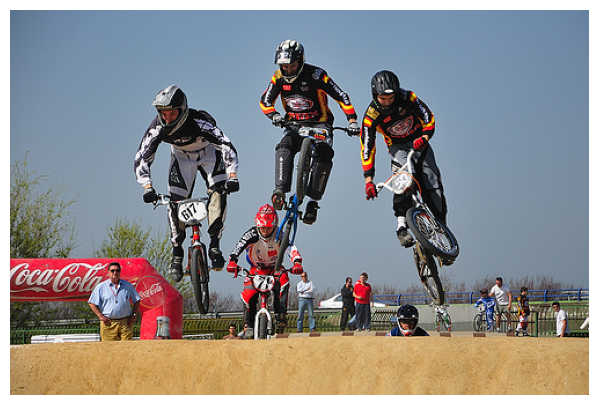

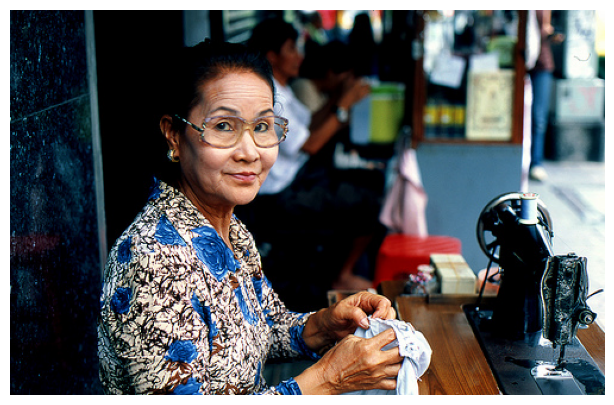

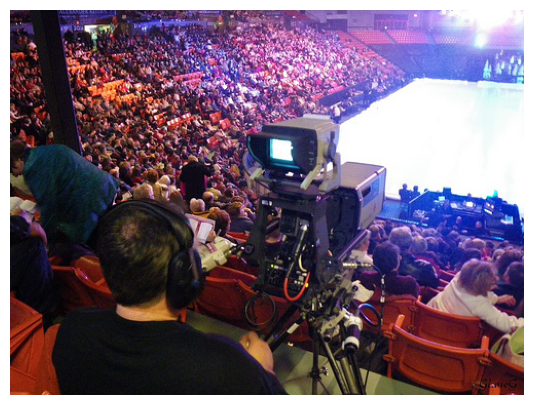

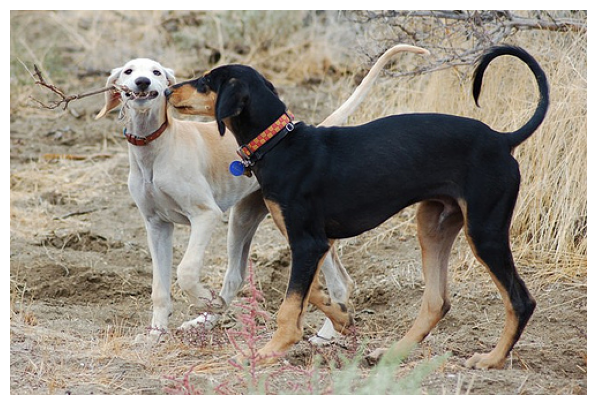

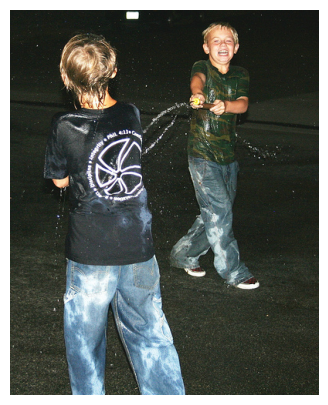

...

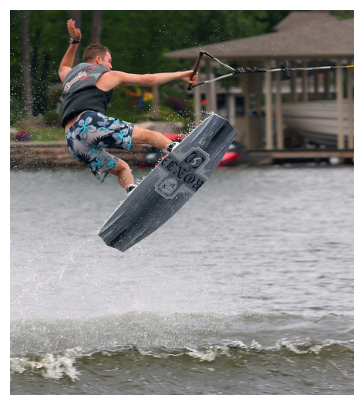

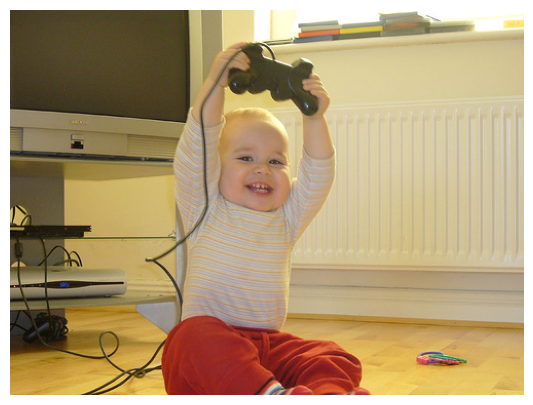

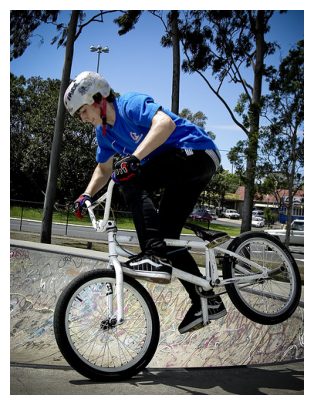

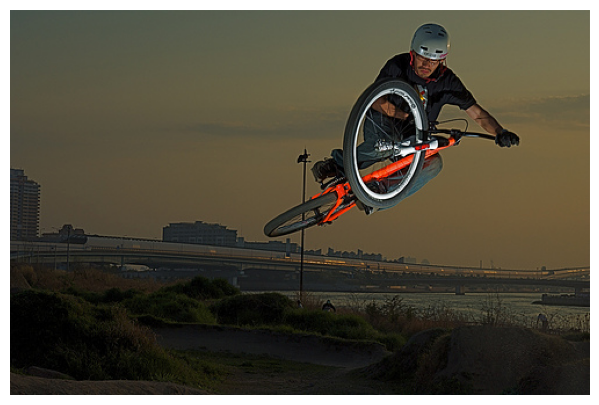

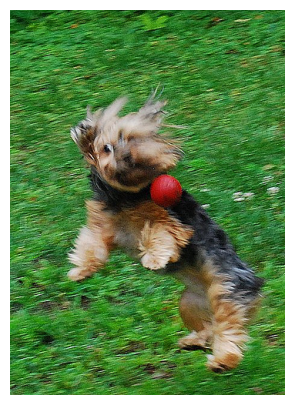

In [23]:
for i in test_im:
    test_box = plt.figure(figsize=(10,5))
    im = Image.open(path_test_images + i)
    train_box.add_subplot(4, 4, 3)
    plt.axis('off')
    plt.imshow(np.array(im))
    plt.show()

## Проверка данных

В некоторых странах, где работает ваша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

> This image is unavailable in your country in compliance with local laws
>

Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, нужно удалить из обучающей выборки.

In [24]:
wnl = WordNetLemmatizer()

tqdm.pandas()

In [25]:
def get_wordnet_pos(word):
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)

def lemmatize(text):
    token = nltk.word_tokenize(text)
    lemma = ' '.join([wnl.lemmatize(i, get_wordnet_pos(i)) for i in token])
    return lemma 


def clear_text(text):
    txt = re.sub(r'[^a-zA-Z]', ' ', text) 
    txt_split = txt.split()
    txt_join = " ".join(txt_split)
    
    return txt_join

### Проверка train_dataset

In [26]:
train_dataset['text_normal'] = train_dataset['query_text'].progress_apply(lemmatize)

  0%|          | 0/5822 [00:00<?, ?it/s]

In [27]:
train_dataset['text_normal'] = train_dataset['text_normal'].progress_apply(clear_text)

  0%|          | 0/5822 [00:00<?, ?it/s]

In [28]:
train_dataset['text_normal'] = train_dataset['text_normal'].str.lower()
train_dataset.head()

,image,query_id,query_text,text_normal
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool


In [29]:
train_text = list(train_dataset['text_normal'])
train_text = ' '.join(train_text)
train_text = train_text.split()
len(train_text)
#train_text

63379

In [30]:
uniq_word = []
for i in train_text:
    if i not in uniq_word:
        uniq_word.append(i)
print(len(uniq_word))
print(uniq_word[:10])

1259
['a', 'young', 'child', 'be', 'wear', 'blue', 'goggles', 'and', 'sit', 'in']


In [31]:
child_synonyms = ['child', 'student', 'kid', 'boy', 'minor', 'pupils', 'son', 'bab', 'infant', 'juven', 'barn', 'minors', 'nino', 'kind', 'juven', 'enfan', 'girl']

In [32]:
b_words = []
for i in uniq_word:
    for j in child_synonyms:
        if j in i:
            b_words.append(i)
b_words

['child',
 'girl',
 'boy',
 'kid',
 'baby',
 'person',
 'kiddie',
 'cowboy',
 'boys',
 'kids',
 'student',
 'showgirl',
 'girls',
 'children']

In [33]:
b_words = ['child', 'girl', 'boy', 'kid', 'baby', 'kiddie', 'boys', 'kids', 'student', 'girls', 'children']

In [34]:
train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image        5822 non-null   object
 1   query_id     5822 non-null   object
 2   query_text   5822 non-null   object
 3   text_normal  5822 non-null   object
dtypes: object(4)
memory usage: 182.1+ KB


In [35]:
ind = []
for i in range(len(train_dataset)):
    for j in b_words:
        if j in train_dataset['text_normal'][i]:
            ind.append(i)
            
len(ind)

1727

In [36]:
bad_query = []
bad_images = []

for i in range(len(train_dataset)):
    for j in b_words:
        if j in train_dataset['text_normal'][i]:
            #if bad_query not in train_dataset['query_id'][i]:
            bad_query.append(train_dataset['query_id'][i])
            #if bad_images not in train_dataset['image'][i]:
            bad_images.append(train_dataset['image'][i])
            
display(len(bad_query))
display(len(bad_images))

1727

1727

In [37]:
bad_query = list(set(bad_query))
bad_images = list(set(bad_images))

In [38]:
display(len(bad_query))
display(len(bad_images))

289

728

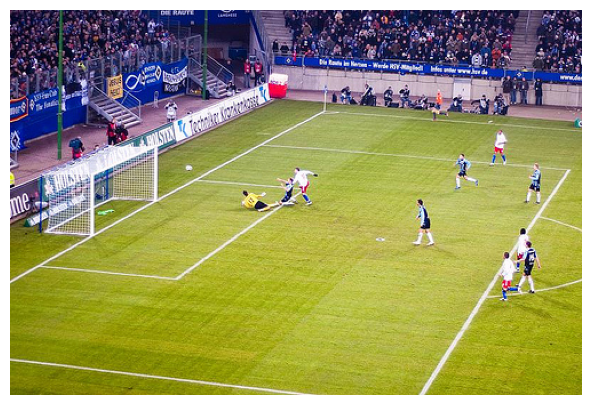

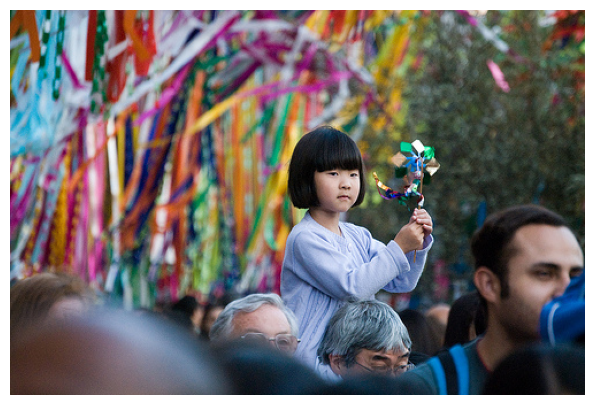

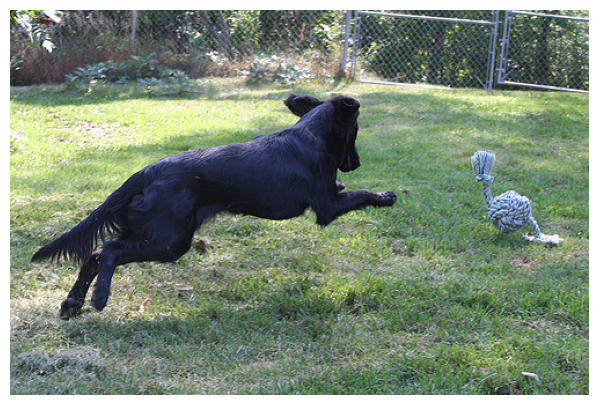

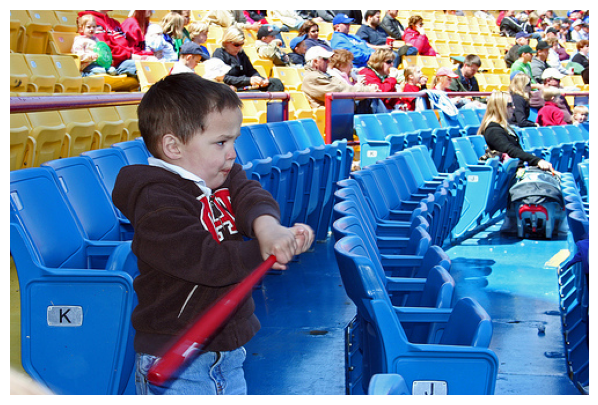

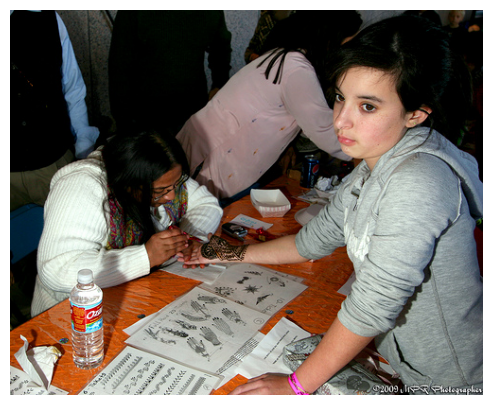

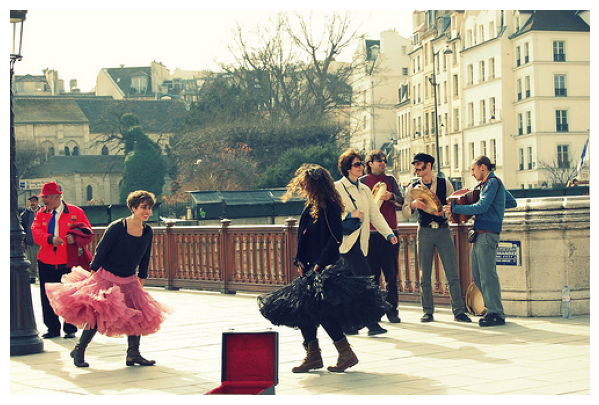

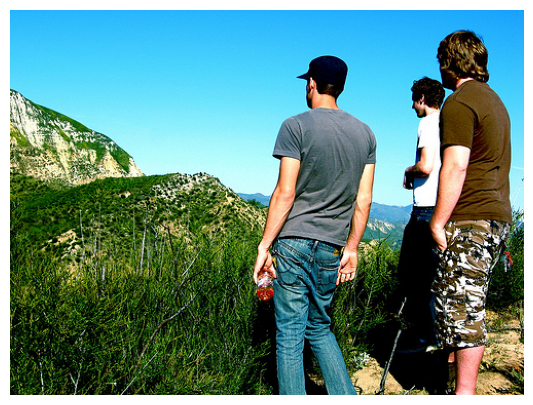

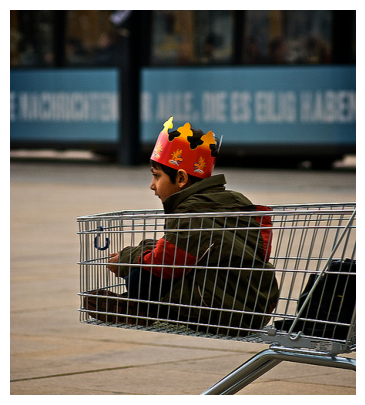

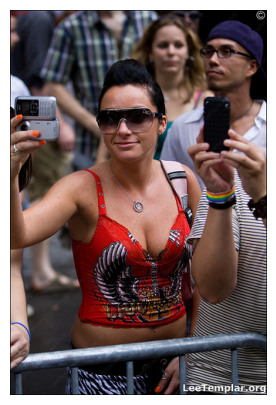

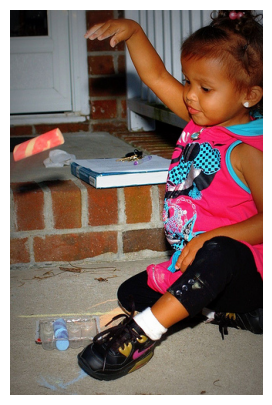

In [39]:
for i in list(bad_images[:10]):
    train_box = plt.figure(figsize=(10,5))
    im = Image.open(path_train_images + i)
    train_box.add_subplot()
    plt.axis('off')
    plt.imshow(np.array(im))
    plt.show()

### Проверка test_queries

In [40]:
test_queries.head()

,Unnamed: 0,query_id,query_text,image
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .",1177994172_10d143cb8d.jpg
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at each other .,1177994172_10d143cb8d.jpg
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each other .,1177994172_10d143cb8d.jpg


In [41]:
test_queries['text_normal'] = test_queries['query_text'].progress_apply(lemmatize)

  0%|          | 0/500 [00:00<?, ?it/s]

In [42]:
test_queries['text_normal'] = test_queries['text_normal'].progress_apply(clear_text)

  0%|          | 0/500 [00:00<?, ?it/s]

In [43]:
test_queries['text_normal'] = test_queries['text_normal'].str.lower()
test_queries.head()

,Unnamed: 0,query_id,query_text,image,text_normal
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .",1177994172_10d143cb8d.jpg,two blonde boy one in a camouflage shirt and the other in blue be have a water fight
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg,two boy be squirt water gun at each other
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg,two boy spray each other with water
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at each other .,1177994172_10d143cb8d.jpg,two child wear jean squirt water at each other
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each other .,1177994172_10d143cb8d.jpg,two young boy be squirt water at each other


In [44]:
test_text = list(test_queries['text_normal'])
test_text = ' '.join(test_text)
test_text = test_text.split()
len(test_text)
#test_text

5620

In [45]:
uniq_word = []
for i in test_text:
    if i not in uniq_word:
        uniq_word.append(i)
print(len(uniq_word))
print(uniq_word[:10])

757
['two', 'blonde', 'boy', 'one', 'in', 'a', 'camouflage', 'shirt', 'and', 'the']


In [46]:
b_words = []
for i in uniq_word:
    for j in child_synonyms:
        if j in i:
            b_words.append(i)
b_words

['boy',
 'child',
 'baby',
 'girl',
 'girls',
 'person',
 'kid',
 'children',
 'kids',
 'boys',
 'cowboy',
 'simpsons',
 'kind',
 'kiddie']

In [47]:
b_words = ['child', 'girl', 'boy', 'kid', 'baby', 'kiddie', 'boys', 'kids', 'student', 'girls', 'children']

In [48]:
ind = []
for i in range(len(test_queries)):
    for j in b_words:
        if j in test_queries['text_normal'][i]:
            ind.append(i)
            
len(ind)

188

In [49]:
test_queries['text_normal'][ind].head()

0    two blonde boy one in a camouflage shirt and the other in blue be have a water fight
1                                               two boy be squirt water gun at each other
2                                                     two boy spray each other with water
3                                          two child wear jean squirt water at each other
4                                             two young boy be squirt water at each other
Name: text_normal, dtype: object

## Агрегация оценок соответствия

In [50]:
0 / 1

0.0

In [51]:
ExpertAnnotations.head(10)

,image,query_id,grade_1_e,grade_2_e,grade_3_e
0,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
1,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
3,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2
4,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1
5,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1,1,1
6,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2
7,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1,1,1
8,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2,2,2
9,106490881_5a2dd9b7bd.jpg,2140182410_8e2a06fbda.jpg#2,2,2,2


In [52]:
ExpertAnnotations[['grade_1_e', 'grade_2_e', 'grade_3_e']] = ExpertAnnotations[['grade_1_e', 'grade_2_e', 'grade_3_e']].replace([1, 2, 3, 4], [0, 0.25, 0.75, 1])

In [53]:
ExpertAnnotations['mean_score_exp'] = (ExpertAnnotations['grade_1_e'] + ExpertAnnotations['grade_2_e'] + ExpertAnnotations['grade_3_e']) / 3
ExpertAnnotations.head()

,image,query_id,grade_1_e,grade_2_e,grade_3_e,mean_score_exp
0,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,0.00,0.00,0.25,0.08
1,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,0.00,0.00,0.25,0.08
2,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,0.00,0.25,0.25,0.17
3,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,0.00,0.00,0.25,0.08
4,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,0.00,0.00,0.00,0.00


In [54]:
CrowdAnnotations.head()

,image,query_id,share_p,count_p_plus,count_p_minus
0,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.00,0,3
1,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.00,0,3
2,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.00,0,3
3,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.00,0,3
4,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.00,0,3


In [55]:
ExpertAnnotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5821 entries, 0 to 5820
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   image           5821 non-null   object 
 1   query_id        5821 non-null   object 
 2   grade_1_e       5821 non-null   float64
 3   grade_2_e       5821 non-null   float64
 4   grade_3_e       5821 non-null   float64
 5   mean_score_exp  5821 non-null   float64
dtypes: float64(4), object(2)
memory usage: 273.0+ KB


In [56]:
CrowdAnnotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47829 entries, 0 to 47828
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   image          47829 non-null  object 
 1   query_id       47829 non-null  object 
 2   share_p        47829 non-null  float64
 3   count_p_plus   47829 non-null  int64  
 4   count_p_minus  47829 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [57]:
expert_crowd = CrowdAnnotations.merge(ExpertAnnotations, left_on = ['query_id', 'image'], right_on = ['query_id', 'image'], how='outer') 

In [58]:
expert_crowd  = expert_crowd[['query_id', 'image', 'share_p', 'mean_score_exp']]

In [59]:
expert_crowd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51322 entries, 0 to 51321
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   query_id        51322 non-null  object 
 1   image           51322 non-null  object 
 2   share_p         47829 non-null  float64
 3   mean_score_exp  5821 non-null   float64
dtypes: float64(2), object(2)
memory usage: 1.6+ MB


In [60]:
expert_crowd = expert_crowd.fillna('unk')
expert_crowd.head(10)

,query_id,image,share_p,mean_score_exp
0,114051287_dd85625a04.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
1,1427391496_ea512cbe7f.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
2,2073964624_52da3a0fc4.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
3,2083434441_a93bc6306b.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
4,2204550058_2707d92338.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
5,2224450291_4c133fabe8.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
6,2248487950_c62d0c81a9.jpg#2,1056338697_4f7d7ce270.jpg,0.33,unk
7,2307118114_c258e3a47e.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
8,2309860995_c2e2a0feeb.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk
9,2436081047_bca044c1d3.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk


In [61]:
list_grade = []
for i in range(len(expert_crowd)):
    if (expert_crowd['share_p'][i] != 'unk') & (expert_crowd['mean_score_exp'][i] != 'unk'):
        final_grade = (expert_crowd['share_p'][i] + expert_crowd['mean_score_exp'][i]) / 2
        list_grade.append(final_grade)
        
    elif (expert_crowd['share_p'][i] != 'unk') & (expert_crowd['mean_score_exp'][i] == 'unk'):
        final_grade = expert_crowd['share_p'][i]
        list_grade.append(final_grade)
                       
    elif (expert_crowd['share_p'][i] == 'unk') & (expert_crowd['mean_score_exp'][i] != 'unk'):
        final_grade = expert_crowd['mean_score_exp'][i]
        list_grade.append(final_grade)

In [62]:
expert_crowd['target'] = list_grade
expert_crowd.head(50)

,query_id,image,share_p,mean_score_exp,target
0,114051287_dd85625a04.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
1,1427391496_ea512cbe7f.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
2,2073964624_52da3a0fc4.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
3,2083434441_a93bc6306b.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
4,2204550058_2707d92338.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
5,2224450291_4c133fabe8.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
6,2248487950_c62d0c81a9.jpg#2,1056338697_4f7d7ce270.jpg,0.33,unk,0.33
7,2307118114_c258e3a47e.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
8,2309860995_c2e2a0feeb.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00
9,2436081047_bca044c1d3.jpg#2,1056338697_4f7d7ce270.jpg,0.00,unk,0.00


In [63]:
expert_crowd = expert_crowd[['query_id', 'image', 'target']]
expert_crowd.head()

,query_id,image,target
0,114051287_dd85625a04.jpg#2,1056338697_4f7d7ce270.jpg,0.00
1,1427391496_ea512cbe7f.jpg#2,1056338697_4f7d7ce270.jpg,0.00
2,2073964624_52da3a0fc4.jpg#2,1056338697_4f7d7ce270.jpg,0.00
3,2083434441_a93bc6306b.jpg#2,1056338697_4f7d7ce270.jpg,0.00
4,2204550058_2707d92338.jpg#2,1056338697_4f7d7ce270.jpg,0.00


In [64]:
expert_crowd.drop_duplicates()
expert_crowd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51322 entries, 0 to 51321
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   query_id  51322 non-null  object 
 1   image     51322 non-null  object 
 2   target    51322 non-null  float64
dtypes: float64(1), object(2)
memory usage: 1.2+ MB


## Векторизация изображений

Перейдём к векторизации изображений.

Самый примитивный способ — прочесть изображение и превратить полученную матрицу в вектор. Такой способ нам не подходит: длина векторов может быть сильно разной, так как размеры изображений разные. Поэтому стоит обратиться к свёрточным сетям: они позволяют "выделить" главные компоненты изображений. Как это сделать? Нужно выбрать какую-либо архитектуру, например ResNet-18, посмотреть на слои и исключить полносвязные слои, которые отвечают за конечное предсказание. При этом можно загрузить модель данной архитектуры, предварительно натренированную на датасете ImageNet.

path_train = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/train_images/'
path_test = 'C:/Users/MSI/Desktop/Koding/Проекты/Сборный - 4/df/to_upload/test_images/'

In [65]:
model = models.resnet18(pretrained=True)

layer = model._modules.get('avgpool')

model.eval()

transforms = torchvision.transforms.Compose([
    torchvision.transforms.Resize(256),
    torchvision.transforms.CenterCrop(224),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


@lru_cache(maxsize=None)
def get_vector(image):
    try:
        image = Image.open(path_train_images  + image)
    except:
        image = Image.open(path_test_images  + image)
    t_img = transforms(image)
    my_embedding = torch.zeros(512)

    def copy_data(m, i, o):
        my_embedding.copy_(o.flatten())              

    h = layer.register_forward_hook(copy_data)
    with torch.no_grad():  
        model(t_img.unsqueeze(0)) 
    h.remove()
    return my_embedding

C:\Users\MSI\AppData\Roaming\Python\Python311\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\MSI\AppData\Roaming\Python\Python311\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


### Векторизация train_dataset

In [66]:
train_dataset.head()

,image,query_id,query_text,text_normal
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool


In [67]:
train_dataset['image_vector'] = train_dataset['image'].progress_apply(get_vector)

  0%|          | 0/5822 [00:00<?, ?it/s]

In [68]:
train_dataset.head(2)

,image,query_id,query_text,text_normal,image_vector
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool,"[tensor(0.6940), tensor(3.0318), tensor(2.9170), tensor(0.9519), tensor(0.9362), tensor(1.2452), tensor(0.8266), tensor(1.1081), tensor(0.1697), tensor(0.3653), tensor(0.2553), tensor(1.4860), tensor(0.3073), tensor(1.2506), tensor(0.0429), tensor(0.8066), tensor(0.9306), tensor(0.6956), tensor(0.2600), tensor(1.6920), tensor(0.3307), tensor(0.8250), tensor(2.2856), tensor(1.9399), tensor(1.1210), tensor(0.7317), tensor(1.3495), tensor(0.4522), tensor(0.3212), tensor(0.5515), tensor(2.1655), tensor(0.2282), tensor(0.7977), tensor(1.5145), tensor(1.0656), tensor(0.9010), tensor(0.5614), tensor(1.0667), tensor(0.2345), tensor(1.1880), tensor(0.8099), tensor(1.1380), tensor(1.2139), tensor(1.0140), tensor(0.4574), tensor(0.8243), tensor(0.6528), tensor(0.0045), tensor(0.7614), tensor(3.0094), tensor(0.3705), tensor(0.1270), tensor(0.6486), tensor(0.1302), tensor(0.4899), tensor(0.2870), tensor(0.3499), tensor(1.4781), tensor(1.4834), tensor(0.8156), tensor(1.8637), tensor(1.4660), tensor(1.3919), tensor(0.9417), tensor(0.7518), tensor(0.2315), tensor(0.1466), tensor(0.5050), tensor(0.1955), tensor(1.2661), tensor(1.3835), tensor(0.6557), tensor(0.2174), tensor(0.1354), tensor(0.7693), tensor(0.1667), tensor(0.7297), tensor(0.4345), tensor(1.1739), tensor(0.3596), tensor(0.4801), tensor(1.0290), tensor(0.2718), tensor(0.7042), tensor(0.8010), tensor(1.4707), tensor(0.6229), tensor(0.5264), tensor(2.2926), tensor(1.0445), tensor(0.5664), tensor(0.8546), tensor(1.0602), tensor(1.7737), tensor(0.2224), tensor(1.0300), tensor(0.6470), tensor(0.6285), tensor(0.2612), tensor(0.5474), ...]"
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitting in a float in a pool .,a young child be wear blue goggles and sit in a float in a pool,"[tensor(0.4289), tensor(1.1512), tensor(1.1857), tensor(1.2805), tensor(0.0330), tensor(2.2680), tensor(0.4657), tensor(0.5804), tensor(0.6416), tensor(0.0695), tensor(0.9402), tensor(2.1436), tensor(1.6434), tensor(0.1803), tensor(0.0465), tensor(0.3682), tensor(1.2018), tensor(0.0865), tensor(0.2802), tensor(0.5353), tensor(0.3634), tensor(0.3084), tensor(1.2564), tensor(1.9813), tensor(1.0789), tensor(0.2584), tensor(0.5797), tensor(1.2891), tensor(0.0963), tensor(0.3551), tensor(1.6413), tensor(0.4182), tensor(0.7979), tensor(1.4673), tensor(1.6053), tensor(1.2011), tensor(1.6311), tensor(1.1924), tensor(0.6129), tensor(1.3684), tensor(1.6434), tensor(1.8543), tensor(1.8279), tensor(0.0643), tensor(1.5778), tensor(0.3122), tensor(0.3211), tensor(0.), tensor(0.3351), tensor(0.6316), tensor(0.1804), tensor(0.5470), tensor(0.5335), tensor(0.0164), tensor(0.7612), tensor(2.1351), tensor(0.5787), tensor(0.3524), tensor(0.8967), tensor(0.4100), tensor(1.4050), tensor(0.0686), tensor(2.0753), tensor(1.4417), tensor(0.1754), tensor(2.4573), tensor(0.5523), tensor(0.2754), tensor(4.2069), tensor(1.5471), tensor(3.3784), tensor(1.3083), tensor(0.4444), tensor(0.8636), tensor(0.5719), tensor(0.1477), tensor(0.3130), tensor(1.1647), tensor(0.6538), tensor(2.5035), tensor(0.7008), tensor(0.5736), tensor(0.6632), tensor(0.9684), tensor(1.7210), tensor(1.7415), tensor(0.0682), tensor(0.5290), tensor(1.6291), tensor(0.5061), tensor(0.1413), tensor(0.6947), tensor(0.7643), tensor(2.3223), tensor(0.4658), tensor(1.0209), tensor(1.1557), tensor(1.2396), tensor(0.3478), tensor(0.2615), ...]"


In [69]:
l_1 = list(train_dataset['image_vector'])
train_vect_image_df = pd.DataFrame(l_1)

In [70]:
train_vect_image_df = train_vect_image_df.astype(float)
train_vect_image_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511
0,0.69,3.03,2.92,0.95,0.94,1.25,0.83,1.11,0.17,0.37,0.26,1.49,0.31,1.25,0.04,0.81,0.93,0.70,0.26,1.69,0.33,0.83,2.29,1.94,1.12,0.73,1.35,0.45,0.32,0.55,2.17,0.23,0.80,1.51,1.07,0.90,0.56,1.07,0.23,1.19,0.81,1.14,1.21,1.01,0.46,0.82,0.65,0.00,0.76,3.01,0.37,0.13,0.65,0.13,0.49,0.29,0.35,1.48,1.48,0.82,1.86,1.47,1.39,0.94,0.75,0.23,0.15,0.51,0.20,1.27,1.38,0.66,0.22,0.14,0.77,0.17,0.73,0.43,1.17,0.36,0.48,1.03,0.27,0.70,0.80,1.47,0.62,0.53,2.29,1.04,0.57,0.85,1.06,1.77,0.22,1.03,0.65,0.63,0.26,0.55,1.55,1.80,0.71,0.61,0.05,0.12,1.66,0.97,0.43,1.03,1.26,0.13,0.12,3.06,1.39,1.72,0.44,0.44,0.63,0.74,0.67,1.63,0.65,1.20,0.15,2.15,0.60,0.49,1.19,2.98,1.35,0.63,1.12,1.27,0.33,0.46,0.12,0.14,0.33,0.39,1.69,0.63,0.06,1.96,1.46,0.15,1.09,0.00,0.84,1.66,2.02,1.22,2.68,0.09,0.04,1.22,1.00,0.99,0.72,0.67,0.81,4.08,1.36,0.69,1.49,0.47,0.96,0.33,0.87,0.36,1.03,0.46,0.64,1.65,1.52,0.03,0.91,1.28,0.36,0.04,0.97,0.87,1.69,1.30,2.18,0.83,0.96,0.21,0.92,0.26,0.98,1.13,1.10,0.54,0.55,4.28,1.85,1.81,1.22,0.27,2.31,0.05,3.11,0.39,2.13,1.78,0.20,0.64,1.08,0.71,0.99,0.77,0.50,0.70,0.05,0.14,0.40,0.73,0.84,1.35,0.76,0.17,0.24,1.13,0.48,0.59,0.04,1.62,1.32,0.75,2.70,0.71,1.41,0.62,0.34,1.17,1.65,1.99,1.07,0.52,1.11,0.48,1.87,0.33,0.37,0.86,0.42,0.41,0.60,1.05,1.04,0.41,0.15,0.25,1.05,1.54,1.04,0.39,1.02,1.10,2.19,1.55,0.12,1.12,0.19,0.31,0.13,0.30,1.12,1.12,0.16,0.51,1.85,0.61,0.13,1.36,0.51,0.32,0.81,1.16,1.28,0.55,1.03,0.13,1.88,0.82,0.63,2.42,0.47,0.66,0.51,1.01,1.75,0.30,1.29,0.55,0.62,0.90,1.77,0.25,1.21,1.13,0.20,0.23,2.18,1.36,0.34,1.02,0.09,0.28,0.24,0.81,2.29,0.25,0.44,0.14,0.35,0.01,2.49,0.35,0.02,0.09,0.23,0.58,0.68,0.86,0.73,1.13,0.81,1.11,1.63,0.37,0.29,1.48,0.21,0.33,0.18,0.05,0.56,0.61,0.23,0.30,1.02,0.78,0.56,0.02,0.85,0.02,0.44,1.13,1.28,0.19,0.18,0.35,1.17,0.09,1.38,0.89,0.58,0.39,0.29,1.48,0.28,1.02,0.00,0.51,0.88,3.27,0.30,0.35,1.52,0.70,0.70,2.39,1.48,1.63,0.91,1.42,1.06,2.83,0.91,0.23,0.50,0.11,1.66,0.97,2.58,0.80,0.58,1.22,0.42,0.70,0.53,0.14,0.22,1.46,0.08,0.66,0.85,1.05,0.81,0.34,0.36,0.70,0.05,0.99,0.63,0.68,0.76,2.85,0.25,1.33

In [71]:
train_vect_image_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Columns: 512 entries, 0 to 511
dtypes: float64(512)
memory usage: 22.7 MB


In [72]:
#train_vect_image_df['query_id'] = train_dataset['query_id']
train_vect_image_df['image'] = train_dataset['image']
train_vect_image_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,image
0,0.69,3.03,2.92,0.95,0.94,1.25,0.83,1.11,0.17,0.37,0.26,1.49,0.31,1.25,0.04,0.81,0.93,0.70,0.26,1.69,0.33,0.83,2.29,1.94,1.12,0.73,1.35,0.45,0.32,0.55,2.17,0.23,0.80,1.51,1.07,0.90,0.56,1.07,0.23,1.19,0.81,1.14,1.21,1.01,0.46,0.82,0.65,0.00,0.76,3.01,0.37,0.13,0.65,0.13,0.49,0.29,0.35,1.48,1.48,0.82,1.86,1.47,1.39,0.94,0.75,0.23,0.15,0.51,0.20,1.27,1.38,0.66,0.22,0.14,0.77,0.17,0.73,0.43,1.17,0.36,0.48,1.03,0.27,0.70,0.80,1.47,0.62,0.53,2.29,1.04,0.57,0.85,1.06,1.77,0.22,1.03,0.65,0.63,0.26,0.55,1.55,1.80,0.71,0.61,0.05,0.12,1.66,0.97,0.43,1.03,1.26,0.13,0.12,3.06,1.39,1.72,0.44,0.44,0.63,0.74,0.67,1.63,0.65,1.20,0.15,2.15,0.60,0.49,1.19,2.98,1.35,0.63,1.12,1.27,0.33,0.46,0.12,0.14,0.33,0.39,1.69,0.63,0.06,1.96,1.46,0.15,1.09,0.00,0.84,1.66,2.02,1.22,2.68,0.09,0.04,1.22,1.00,0.99,0.72,0.67,0.81,4.08,1.36,0.69,1.49,0.47,0.96,0.33,0.87,0.36,1.03,0.46,0.64,1.65,1.52,0.03,0.91,1.28,0.36,0.04,0.97,0.87,1.69,1.30,2.18,0.83,0.96,0.21,0.92,0.26,0.98,1.13,1.10,0.54,0.55,4.28,1.85,1.81,1.22,0.27,2.31,0.05,3.11,0.39,2.13,1.78,0.20,0.64,1.08,0.71,0.99,0.77,0.50,0.70,0.05,0.14,0.40,0.73,0.84,1.35,0.76,0.17,0.24,1.13,0.48,0.59,0.04,1.62,1.32,0.75,2.70,0.71,1.41,0.62,0.34,1.17,1.65,1.99,1.07,0.52,1.11,0.48,1.87,0.33,0.37,0.86,0.42,0.41,0.60,1.05,1.04,0.41,0.15,0.25,1.05,1.54,1.04,0.39,1.02,1.10,2.19,1.55,0.12,1.12,0.19,0.31,0.13,0.30,1.12,1.12,0.16,0.51,1.85,0.61,0.13,1.36,0.51,0.32,0.81,1.16,1.28,0.55,1.03,0.13,1.88,0.82,0.63,2.42,0.47,0.66,0.51,1.01,1.75,0.30,1.29,0.55,0.62,0.90,1.77,0.25,1.21,1.13,0.20,0.23,2.18,1.36,0.34,1.02,0.09,0.28,0.24,0.81,2.29,0.25,0.44,0.14,0.35,0.01,2.49,0.35,0.02,0.09,0.23,0.58,0.68,0.86,0.73,1.13,0.81,1.11,1.63,0.37,0.29,1.48,0.21,0.33,0.18,0.05,0.56,0.61,0.23,0.30,1.02,0.78,0.56,0.02,0.85,0.02,0.44,1.13,1.28,0.19,0.18,0.35,1.17,0.09,1.38,0.89,0.58,0.39,0.29,1.48,0.28,1.02,0.00,0.51,0.88,3.27,0.30,0.35,1.52,0.70,0.70,2.39,1.48,1.63,0.91,1.42,1.06,2.83,0.91,0.23,0.50,0.11,1.66,0.97,2.58,0.80,0.58,1.22,0.42,0.70,0.53,0.14,0.22,1.46,0.08,0.66,0.85,1.05,0.81,0.34,0.36,0.70,0.05,0.99,0.63,0.68,0.76,2.85,0.2

## Векторизация текстов

Следующий этап — векторизация текстов. Вы можете поэкспериментировать с несколькими способами векторизации текстов:

- tf-idf
- word2vec
- \*трансформеры (например Bert)

\* — если вы изучали трансформеры в спринте Машинное обучение для текстов.


In [73]:
corpus = list(train_dataset['text_normal'])
corpus_test = list(test_queries['text_normal'])

In [74]:
corpus = list(train_dataset['text_normal'])
stop_words = set(stopwords.words('english'))

### Векторизация train_dataset

In [75]:
vectorizer = TfidfVectorizer(stop_words=list(stop_words))
tf_idf_train = vectorizer.fit_transform(corpus)

print("Размер матрицы:", tf_idf_train.shape)

Размер матрицы: (5822, 1190)


In [76]:
matrix_tf_idf_train = pd.DataFrame(tf_idf_train.todense())
#matrix_tf_idf_train.head(5)
matrix_tf_idf_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Columns: 1190 entries, 0 to 1189
dtypes: float64(1190)
memory usage: 52.9 MB


In [77]:
#matrix_tf_idf_train['image'] = train_dataset['image']
matrix_tf_idf_train['query_id'] = train_dataset['query_id']
matrix_tf_idf_train.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

## Объединение векторов

Подготовьте данные для обучения: объедините векторы изображений и векторы текстов с целевой переменной.

### Удаление строк содержащих юридически вредный контент

In [78]:
matrix_tf_idf_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Columns: 1191 entries, 0 to query_id
dtypes: float64(1190), object(1)
memory usage: 52.9+ MB


In [79]:
train_vect_image_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Columns: 513 entries, 0 to image
dtypes: float64(512), object(1)
memory usage: 22.8+ MB


In [80]:
display(expert_crowd.head())
expert_crowd.info()

,query_id,image,target
0,114051287_dd85625a04.jpg#2,1056338697_4f7d7ce270.jpg,0.00
1,1427391496_ea512cbe7f.jpg#2,1056338697_4f7d7ce270.jpg,0.00
2,2073964624_52da3a0fc4.jpg#2,1056338697_4f7d7ce270.jpg,0.00
3,2083434441_a93bc6306b.jpg#2,1056338697_4f7d7ce270.jpg,0.00
4,2204550058_2707d92338.jpg#2,1056338697_4f7d7ce270.jpg,0.00


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51322 entries, 0 to 51321
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   query_id  51322 non-null  object 
 1   image     51322 non-null  object 
 2   target    51322 non-null  float64
dtypes: float64(1), object(2)
memory usage: 1.2+ MB


In [81]:
display(bad_query[:10])
display(bad_images[:10])

['373394550_1b2296b8c4.jpg#2',
 '3470951932_27ed74eb0b.jpg#2',
 '2735558076_0d7bbc18fc.jpg#2',
 '2510020918_b2ca0fb2aa.jpg#2',
 '136644343_0e2b423829.jpg#2',
 '3658427967_6e2e57458d.jpg#2',
 '2844641033_dab3715a99.jpg#2',
 '533979933_a95b03323b.jpg#2',
 '2646116932_232573f030.jpg#2',
 '2774430374_fee1d793e7.jpg#2']

['3232470286_903a61ea16.jpg',
 '2666205903_8d287669e1.jpg',
 '1107246521_d16a476380.jpg',
 '2447284966_d6bbdb4b6e.jpg',
 '3243588540_b418ac7eda.jpg',
 '3565598162_56044bc2f7.jpg',
 '3045613316_4e88862836.jpg',
 '2378149488_648e5deeac.jpg',
 '2644430445_47c985a2ee.jpg',
 '2901074943_041aba4607.jpg']

In [82]:
bad_index = [] 

for i in range(len(expert_crowd)):
    for j in bad_query:
        if expert_crowd['query_id'][i] == j:
            bad_index.append(i)
            
display(len(bad_index))
display(bad_index[:10])

14214

[0, 1, 9, 10, 11, 12, 13, 17, 18, 27]

for i in range(len(expert_crowd)):
    for k in bad_images:
        if k == expert_crowd['image'][i]:
            if i not in bad_index:
                bad_index.append(i)
                
display(len(bad_index))
display(bad_index[:10])

matrix_tf_idf_train_1 = matrix_tf_idf_train.head(100)
train_vect_image_df_1 = train_vect_image_df.head(100)
expert_crowd_1 = expert_crowd.head(100)

In [83]:
expert_crowd = expert_crowd.drop(index = bad_index, axis=0)
expert_crowd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37108 entries, 2 to 51321
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   query_id  37108 non-null  object 
 1   image     37108 non-null  object 
 2   target    37108 non-null  float64
dtypes: float64(1), object(2)
memory usage: 1.1+ MB


### Объединяем данные

In [84]:
train = expert_crowd.merge(matrix_tf_idf_train, on = ['query_id'], how='left')
train = train.drop_duplicates()
train.reset_index(drop= True , inplace= True )

In [85]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37108 entries, 0 to 37107
Columns: 1193 entries, query_id to 1189
dtypes: float64(1191), object(2)
memory usage: 337.8+ MB


In [86]:
train = train.merge(train_vect_image_df, on = ['image'], how='left')
train = train.drop_duplicates()
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37108 entries, 0 to 214813
Columns: 1705 entries, query_id to 511_y
dtypes: float64(1703), object(2)
memory usage: 483.0+ MB


In [87]:
train = train.dropna ()
train.reset_index(drop= True , inplace= True )
train.head()

query_id                      image  target  0_x  1_x  \
0  2073964624_52da3a0fc4.jpg#2  1056338697_4f7d7ce270.jpg    0.00 0.00 0.00   
1  2083434441_a93bc6306b.jpg#2  1056338697_4f7d7ce270.jpg    0.00 0.00 0.00   
2  2204550058_2707d92338.jpg#2  1056338697_4f7d7ce270.jpg    0.00 0.00 0.00   
3  2224450291_4c133fabe8.jpg#2  1056338697_4f7d7ce270.jpg    0.00 0.00 0.00   
4  2248487950_c62d0c81a9.jpg#2  1056338697_4f7d7ce270.jpg    0.33 0.00 0.00   

   2_x  3_x  4_x  5_x  6_x  7_x  8_x  9_x  10_x  11_x  12_x  13_x  14_x  15_x  \
0 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   16_x  17_x  18_x  19_x  20_x  21_x  22_x  23_x  24_x  25_x  26_x  27_x  \
0  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   28_x  29_x  30_x  31_x  32_x  33_x  34_x  35_x  36_x  37_x  38_x  39_x  \
0  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   40_x  41_x  42_x  43_x  44_x  45_x  46_x  47_x  48_x  49_x  50_x  51_x  \
0  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   52_x  53_x  54_x  55_x  56_x  57_x  58_x  59_x  60_x  61_x  62_x  63_x  \
0  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   64_x  65_x  66_x  67_x  68_x  69_x  70_x  71_x  72_x  73_x  74_x  75_x  \
0  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   76_x  77_x  78_x  79_x  80_x  81_x  82_x  83_x  84_x  85_x  86_x  87_x  \
0  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
3  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
4  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   

   88_x  89_x  90_x  91_x  92_x  93_x  94_x  95_x  96_x  97_x  98_x  99_x  \
0  0.00  0.00  0.00  0.00  0.30  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
1  0.00  0.00  0.38  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
2  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  

In [88]:
train.columns = train.columns.astype(str)
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35999 entries, 0 to 35998
Columns: 1705 entries, query_id to 511_y
dtypes: float64(1703), object(2)
memory usage: 468.3+ MB


## Обучение модели предсказания соответствия

Для обучения разделите датасет на тренировочную и тестовую выборки. Простое случайное разбиение не подходит: нужно исключить попадание изображения и в обучающую, и в тестовую выборки.
Для того чтобы учесть изображения при разбиении, можно воспользоваться классом [GroupShuffleSplit](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GroupShuffleSplit.html) из библиотеки sklearn.model_selection.

Код ниже разбивает датасет на тренировочную и тестовую выборки в пропорции 7:3 так, что строки с одинаковым значением 'group_column' будут содержаться либо в тестовом, либо в тренировочном датасете.

```
from sklearn.model_selection import GroupShuffleSplit
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)
train_indices, test_indices = next(gss.split(X=df.drop(columns=['target']), y=df['target'], groups=df['group_column']))
train_df, test_df = df.loc[train_indices], df.loc[test_indices]

```

Какую модель использовать — выберите самостоятельно. Также вам предстоит выбрать метрику качества либо реализовать свою.

### Разделение данных на выборки

In [89]:
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)

train_indices, valid_indices = next(gss.split(X=train.drop(columns=['target', 'image', 'query_id']), y=train['target'], groups=train['image']))

train_df, valid_df = train.loc[train_indices], train.loc[valid_indices]

In [90]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25039 entries, 0 to 35998
Columns: 1705 entries, query_id to 511_y
dtypes: float64(1703), object(2)
memory usage: 325.9+ MB


In [91]:
valid_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10960 entries, 46 to 35993
Columns: 1705 entries, query_id to 511_y
dtypes: float64(1703), object(2)
memory usage: 142.7+ MB


In [92]:
features_train = train_df.drop(columns=['target', 'image', 'query_id'])
target_train = train_df['target']

In [93]:
features_valid = valid_df.drop(columns=['target', 'image', 'query_id'])
target_valid = valid_df['target']

### LinearRegression

In [94]:
model_l = LinearRegression()

In [95]:
model_l.fit(features_train, target_train)

LinearRegression()

In [96]:
predict_test = model_l.predict(features_valid)

In [97]:
print(mean_absolute_error(target_valid, predict_test))

0.1426841299447336


### Catboost

In [98]:
model_catboost = CatBoostRegressor()

In [99]:
model_catboost.fit(features_train, target_train)

Learning rate set to 0.068102
0:	learn: 0.2189019	total: 184ms	remaining: 3m 3s
1:	learn: 0.2184156	total: 216ms	remaining: 1m 47s
2:	learn: 0.2179322	total: 246ms	remaining: 1m 21s
3:	learn: 0.2174327	total: 276ms	remaining: 1m 8s
4:	learn: 0.2171389	total: 307ms	remaining: 1m 1s
5:	learn: 0.2166341	total: 337ms	remaining: 55.9s
6:	learn: 0.2162744	total: 369ms	remaining: 52.3s
7:	learn: 0.2157740	total: 400ms	remaining: 49.7s
8:	learn: 0.2154023	total: 435ms	remaining: 47.9s
9:	learn: 0.2150498	total: 467ms	remaining: 46.3s
10:	learn: 0.2147602	total: 500ms	remaining: 45s
11:	learn: 0.2144960	total: 538ms	remaining: 44.3s
12:	learn: 0.2141256	total: 574ms	remaining: 43.5s
13:	learn: 0.2138851	total: 620ms	remaining: 43.7s
14:	learn: 0.2135994	total: 654ms	remaining: 43s
15:	learn: 0.2134716	total: 688ms	remaining: 42.3s
16:	learn: 0.2132580	total: 725ms	remaining: 41.9s
17:	learn: 0.2129780	total: 757ms	remaining: 41.3s
18:	learn: 0.2127803	total: 789ms	remaining: 40.8s
19:	learn: 0.

165:	learn: 0.1971971	total: 5.1s	remaining: 25.6s
166:	learn: 0.1971047	total: 5.13s	remaining: 25.6s
167:	learn: 0.1970171	total: 5.16s	remaining: 25.5s
168:	learn: 0.1969382	total: 5.19s	remaining: 25.5s
169:	learn: 0.1968292	total: 5.22s	remaining: 25.5s
170:	learn: 0.1966827	total: 5.25s	remaining: 25.4s
171:	learn: 0.1965841	total: 5.28s	remaining: 25.4s
172:	learn: 0.1965287	total: 5.3s	remaining: 25.3s
173:	learn: 0.1964231	total: 5.33s	remaining: 25.3s
174:	learn: 0.1963171	total: 5.36s	remaining: 25.3s
175:	learn: 0.1962238	total: 5.38s	remaining: 25.2s
176:	learn: 0.1960937	total: 5.41s	remaining: 25.2s
177:	learn: 0.1959508	total: 5.44s	remaining: 25.1s
178:	learn: 0.1958193	total: 5.46s	remaining: 25.1s
179:	learn: 0.1957063	total: 5.49s	remaining: 25s
180:	learn: 0.1956140	total: 5.52s	remaining: 25s
181:	learn: 0.1955111	total: 5.54s	remaining: 24.9s
182:	learn: 0.1954423	total: 5.57s	remaining: 24.9s
183:	learn: 0.1953103	total: 5.6s	remaining: 24.8s
184:	learn: 0.19521

327:	learn: 0.1840167	total: 9.46s	remaining: 19.4s
328:	learn: 0.1839660	total: 9.49s	remaining: 19.4s
329:	learn: 0.1839124	total: 9.52s	remaining: 19.3s
330:	learn: 0.1838581	total: 9.56s	remaining: 19.3s
331:	learn: 0.1838015	total: 9.58s	remaining: 19.3s
332:	learn: 0.1837324	total: 9.61s	remaining: 19.3s
333:	learn: 0.1836753	total: 9.64s	remaining: 19.2s
334:	learn: 0.1836116	total: 9.67s	remaining: 19.2s
335:	learn: 0.1835581	total: 9.69s	remaining: 19.2s
336:	learn: 0.1835108	total: 9.72s	remaining: 19.1s
337:	learn: 0.1834603	total: 9.75s	remaining: 19.1s
338:	learn: 0.1834160	total: 9.77s	remaining: 19.1s
339:	learn: 0.1833652	total: 9.8s	remaining: 19s
340:	learn: 0.1833066	total: 9.82s	remaining: 19s
341:	learn: 0.1832401	total: 9.85s	remaining: 19s
342:	learn: 0.1831769	total: 9.88s	remaining: 18.9s
343:	learn: 0.1830888	total: 9.91s	remaining: 18.9s
344:	learn: 0.1830407	total: 9.94s	remaining: 18.9s
345:	learn: 0.1829917	total: 9.96s	remaining: 18.8s
346:	learn: 0.18293

491:	learn: 0.1750972	total: 13.9s	remaining: 14.3s
492:	learn: 0.1750562	total: 13.9s	remaining: 14.3s
493:	learn: 0.1749923	total: 13.9s	remaining: 14.3s
494:	learn: 0.1749457	total: 13.9s	remaining: 14.2s
495:	learn: 0.1749013	total: 14s	remaining: 14.2s
496:	learn: 0.1748675	total: 14s	remaining: 14.2s
497:	learn: 0.1748203	total: 14s	remaining: 14.1s
498:	learn: 0.1747265	total: 14.1s	remaining: 14.1s
499:	learn: 0.1746879	total: 14.1s	remaining: 14.1s
500:	learn: 0.1746398	total: 14.1s	remaining: 14.1s
501:	learn: 0.1745997	total: 14.1s	remaining: 14s
502:	learn: 0.1745466	total: 14.2s	remaining: 14s
503:	learn: 0.1745210	total: 14.2s	remaining: 14s
504:	learn: 0.1744563	total: 14.2s	remaining: 13.9s
505:	learn: 0.1744159	total: 14.2s	remaining: 13.9s
506:	learn: 0.1743693	total: 14.3s	remaining: 13.9s
507:	learn: 0.1743249	total: 14.3s	remaining: 13.8s
508:	learn: 0.1742449	total: 14.3s	remaining: 13.8s
509:	learn: 0.1741982	total: 14.3s	remaining: 13.8s
510:	learn: 0.1741465	to

654:	learn: 0.1679780	total: 18.3s	remaining: 9.64s
655:	learn: 0.1679395	total: 18.3s	remaining: 9.61s
656:	learn: 0.1679224	total: 18.4s	remaining: 9.58s
657:	learn: 0.1679121	total: 18.4s	remaining: 9.55s
658:	learn: 0.1678761	total: 18.4s	remaining: 9.53s
659:	learn: 0.1678290	total: 18.4s	remaining: 9.5s
660:	learn: 0.1677983	total: 18.5s	remaining: 9.47s
661:	learn: 0.1677296	total: 18.5s	remaining: 9.45s
662:	learn: 0.1676904	total: 18.5s	remaining: 9.42s
663:	learn: 0.1676568	total: 18.6s	remaining: 9.39s
664:	learn: 0.1675822	total: 18.6s	remaining: 9.36s
665:	learn: 0.1675532	total: 18.6s	remaining: 9.34s
666:	learn: 0.1675007	total: 18.6s	remaining: 9.31s
667:	learn: 0.1674653	total: 18.7s	remaining: 9.28s
668:	learn: 0.1674448	total: 18.7s	remaining: 9.25s
669:	learn: 0.1673957	total: 18.7s	remaining: 9.23s
670:	learn: 0.1673475	total: 18.8s	remaining: 9.2s
671:	learn: 0.1672857	total: 18.8s	remaining: 9.17s
672:	learn: 0.1672525	total: 18.8s	remaining: 9.15s
673:	learn: 0.

817:	learn: 0.1622477	total: 22.9s	remaining: 5.09s
818:	learn: 0.1622033	total: 22.9s	remaining: 5.06s
819:	learn: 0.1621857	total: 22.9s	remaining: 5.03s
820:	learn: 0.1621524	total: 22.9s	remaining: 5s
821:	learn: 0.1621156	total: 23s	remaining: 4.97s
822:	learn: 0.1620913	total: 23s	remaining: 4.95s
823:	learn: 0.1620456	total: 23s	remaining: 4.92s
824:	learn: 0.1620137	total: 23.1s	remaining: 4.89s
825:	learn: 0.1619656	total: 23.1s	remaining: 4.86s
826:	learn: 0.1619372	total: 23.1s	remaining: 4.83s
827:	learn: 0.1618649	total: 23.1s	remaining: 4.8s
828:	learn: 0.1618218	total: 23.2s	remaining: 4.78s
829:	learn: 0.1617821	total: 23.2s	remaining: 4.75s
830:	learn: 0.1617249	total: 23.2s	remaining: 4.72s
831:	learn: 0.1616993	total: 23.2s	remaining: 4.69s
832:	learn: 0.1616619	total: 23.3s	remaining: 4.67s
833:	learn: 0.1616396	total: 23.3s	remaining: 4.64s
834:	learn: 0.1616171	total: 23.3s	remaining: 4.61s
835:	learn: 0.1615736	total: 23.4s	remaining: 4.58s
836:	learn: 0.1614992	

978:	learn: 0.1568902	total: 27.3s	remaining: 586ms
979:	learn: 0.1568555	total: 27.4s	remaining: 558ms
980:	learn: 0.1568405	total: 27.4s	remaining: 530ms
981:	learn: 0.1568153	total: 27.4s	remaining: 502ms
982:	learn: 0.1567488	total: 27.4s	remaining: 474ms
983:	learn: 0.1566990	total: 27.5s	remaining: 447ms
984:	learn: 0.1566762	total: 27.5s	remaining: 419ms
985:	learn: 0.1566596	total: 27.5s	remaining: 391ms
986:	learn: 0.1566158	total: 27.5s	remaining: 363ms
987:	learn: 0.1565806	total: 27.6s	remaining: 335ms
988:	learn: 0.1565565	total: 27.6s	remaining: 307ms
989:	learn: 0.1565222	total: 27.6s	remaining: 279ms
990:	learn: 0.1564885	total: 27.7s	remaining: 251ms
991:	learn: 0.1564397	total: 27.7s	remaining: 223ms
992:	learn: 0.1564020	total: 27.7s	remaining: 195ms
993:	learn: 0.1563841	total: 27.8s	remaining: 168ms
994:	learn: 0.1563443	total: 27.8s	remaining: 140ms
995:	learn: 0.1563226	total: 27.8s	remaining: 112ms
996:	learn: 0.1563023	total: 27.8s	remaining: 83.8ms
997:	learn:

In [100]:
predict_test_catboost = model_catboost.predict(features_valid)
print(mean_absolute_error(target_valid, predict_test_catboost))

0.1145989136947711


## Тестирование модели

Настало время протестировать модель. Для этого получите эмбеддинги для всех тестовых изображений из папки `test_images`, выберите случайные 10 запросов из файла `test_queries.csv` и для каждого запроса выведите наиболее релевантное изображение. Сравните визуально качество поиска.

In [101]:
test_queries.info()
display(test_queries.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   500 non-null    int64 
 1   query_id     500 non-null    object
 2   query_text   500 non-null    object
 3   image        500 non-null    object
 4   text_normal  500 non-null    object
dtypes: int64(1), object(4)
memory usage: 19.7+ KB


,Unnamed: 0,query_id,query_text,image,text_normal
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .",1177994172_10d143cb8d.jpg,two blonde boy one in a camouflage shirt and the other in blue be have a water fight
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg,two boy be squirt water gun at each other
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg,two boy spray each other with water
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at each other .,1177994172_10d143cb8d.jpg,two child wear jean squirt water at each other
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each other .,1177994172_10d143cb8d.jpg,two young boy be squirt water at each other


In [102]:
def get_image_vector_df(df):
    df['image_vector'] = df['image'].progress_apply(get_vector)
    im_vector = list(np.array(df['image_vector']))
    im_vector = pd.DataFrame(im_vector)
    im_vector = im_vector.astype(float)
    im_vector['image'] = test_queries['image']
    return im_vector

In [103]:
im_vector = get_image_vector_df(test_queries).drop_duplicates()
im_vector.reset_index(drop= True , inplace= True)
im_vector.info()

  0%|          | 0/500 [00:00<?, ?it/s]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Columns: 513 entries, 0 to image
dtypes: float64(512), object(1)
memory usage: 400.9+ KB


In [104]:
im_vector.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,image
0,0.44,2.33,0.01,2.39,0.02,0.33,1.68,1.90,0.22,0.03,0.19,1.29,0.23,0.04,0.16,0.96,1.37,0.03,0.47,1.10,0.36,0.11,1.59,2.09,2.23,0.04,0.03,1.05,0.03,0.45,0.88,0.37,0.02,0.12,0.80,0.74,0.25,0.72,1.32,0.14,0.19,0.32,0.73,0.04,2.32,0.47,0.42,0.72,0.50,0.39,0.21,0.44,1.41,0.69,0.09,2.99,0.04,1.04,0.58,0.20,0.12,0.05,2.19,1.69,0.02,0.38,2.91,0.28,0.69,0.66,1.89,0.51,0.92,0.08,1.29,0.11,0.99,1.64,0.60,2.34,0.23,0.56,0.46,2.95,0.79,0.30,0.80,0.36,4.36,1.13,0.36,3.02,0.10,2.72,0.17,1.13,0.58,0.74,0.66,2.73,0.13,1.35,0.88,0.39,0.59,0.00,5.00,0.04,1.42,0.59,0.79,0.57,0.65,0.85,0.42,1.35,0.62,0.21,0.64,0.88,0.27,0.93,0.34,0.95,0.98,2.53,0.03,0.86,0.15,0.02,0.33,0.33,0.62,0.08,0.94,0.30,0.78,0.21,0.53,0.17,2.43,1.02,0.02,0.20,0.33,1.68,0.74,0.79,0.60,0.68,0.14,1.16,0.76,0.62,0.00,1.24,1.69,0.48,0.16,0.43,0.47,0.00,0.49,0.00,0.84,0.87,1.34,0.02,0.79,0.68,0.19,0.18,2.41,0.00,0.08,0.51,0.51,1.22,0.46,0.96,1.40,0.30,0.31,0.84,2.43,0.98,0.34,0.24,0.39,1.56,1.42,0.45,0.32,0.63,0.22,0.57,0.56,0.60,0.44,0.62,3.29,0.17,0.68,0.30,1.50,2.34,0.00,0.68,1.18,2.29,1.20,0.27,0.06,1.25,0.10,1.31,0.36,0.08,0.01,0.66,0.18,0.57,0.18,0.16,0.31,1.19,1.31,0.62,2.72,2.42,1.11,0.68,2.11,0.27,0.78,2.63,3.11,0.00,0.51,1.64,2.31,0.34,0.00,0.09,0.68,0.00,1.01,0.85,0.29,1.36,0.57,1.46,0.11,1.22,0.42,0.00,0.98,0.35,0.68,2.73,1.35,0.40,0.88,0.22,0.02,0.98,0.12,0.55,1.81,0.55,0.66,0.02,0.88,4.89,0.23,1.42,1.90,0.06,0.02,0.34,0.35,1.06,0.32,1.18,0.93,0.67,0.05,0.07,1.71,0.81,0.72,0.03,1.00,2.19,0.61,1.13,0.30,0.09,0.17,0.41,0.07,1.35,0.82,0.06,1.59,2.08,0.52,0.76,0.20,2.79,0.01,2.32,2.26,1.88,0.82,0.33,0.28,0.79,1.08,0.26,0.98,0.06,0.10,0.04,0.27,0.52,0.33,0.32,0.23,0.18,0.87,0.54,1.08,0.64,0.15,0.85,0.11,0.36,1.26,1.01,0.26,2.09,1.41,1.20,0.05,0.54,0.89,0.11,0.76,1.35,0.47,0.56,0.49,0.46,0.04,0.95,1.23,1.57,0.14,0.81,0.02,0.89,0.46,0.22,0.24,0.15,0.35,0.32,2.70,0.23,0.53,0.37,0.01,0.12,0.56,2.54,0.25,0.79,0.56,3.35,0.88,0.42,0.92,0.67,3.55,0.61,2.20,0.64,5.69,0.63,0.51,0.05,0.00,0.99,0.65,0.03,0.58,0.70,0.11,0.75,0.83,2.11,0.71,0.28,0.38,1.02,0.08,1.33,0.44,2.22,0.8

In [105]:
def get_stop_word(text):
    text = lemmatize(text)
    text = clear_text(text)
    split_text = str(text).split(' ')
    re = []
    rov = []
    for i in b_words:
        for m in split_text:
            if i == m:
                if re <= rov:
                    re.append(m)
                
    return re   

In [106]:
def for_bool(text_split):
    text_list = []
    for i in text_split:
        #l = list(map(list, i))
        text_list.append([i])
    
    return text_list

In [107]:
def get_image(text):
    stop_word = get_stop_word(text)
    
    text = lemmatize(text)
    text = clear_text(text)
    text_split = str(text).split(' ')
    text_bool = for_bool(text_split)
    text_list = [text]
    
    if stop_word in text_bool:
        disc = 'This image is unavailable in your country in compliance with local laws.'
        return disc
        
    else:
        tf_idf = vectorizer.transform(text_list)
        tf_idf_df = pd.DataFrame(tf_idf.todense())
        tf_idf_df['query'] = text
        #return tf_idf_df
              
        vect = im_vector
        list_im = text_list * len(vect)
        vect['query'] = list_im
        #return im_vector.head()
                
        image_df = tf_idf_df.merge(vect, on = ['query'], how='inner')
        image_df.columns = image_df.columns.astype(str)
        #return image_df.head()
                
        features = image_df.drop(columns=['query', 'image'])
        predict = model_catboost.predict(features)
                
        image_df['predict'] = predict
        score = image_df['predict'].max()
        best = image_df['predict'].sort_values(ascending=False).head(1).index
        #return best
                
        image_name = im_vector['image'][best]
        image_name = image_name.max()
        #return image_name
        image = path_test_images + image_name
                
        return image, score
    

In [108]:
def get_inferens(text):
    try:
        image, score = get_image(text)
        display(score)
        display(Image.open(image))
    except:
        disc = get_image(text)
        display(disc)
    
    

0.13154471350494532

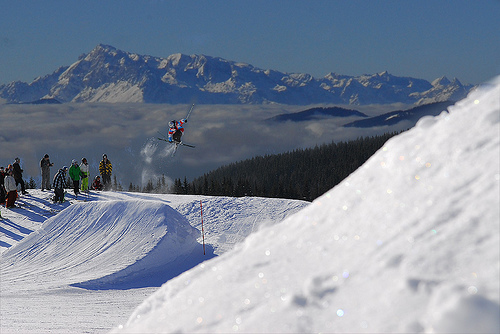

In [109]:
get_inferens('snow')

In [110]:
get_inferens('Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .')

'This image is unavailable in your country in compliance with local laws.'

In [111]:
uniq_query = test_queries['query_text'].unique()
uniq_query[:10]

array(['Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .',
       'Two boys are squirting water guns at each other .',
       'Two boys spraying each other with water',
       'Two children wearing jeans squirt water at each other .',
       'Two young boys are squirting water at each other .',
       'A baby girl playing at a park .',
       'A closeup of a child on a playground with adult supervision .',
       'A young boy poses for a picture in front of a playground .',
       'A young girl is smiling in front of the camera at a park .',
       'There is a little blond hair girl with a green sweatshirt and a red shirt playing on a playground .'],
      dtype=object)

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

'This image is unavailable in your country in compliance with local laws.'

0.1382133570055026

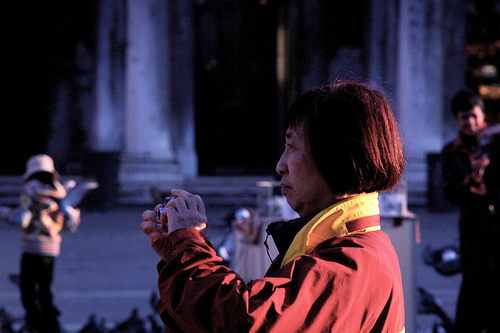

0.19551213817172083

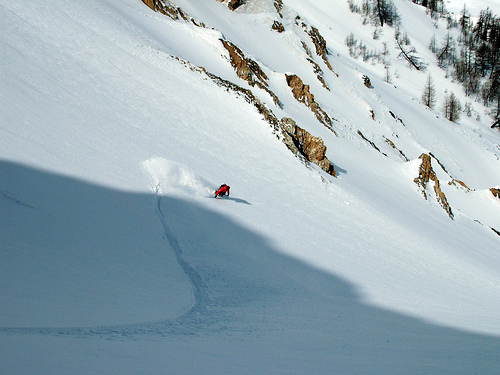

'This image is unavailable in your country in compliance with local laws.'

0.14547953314794737

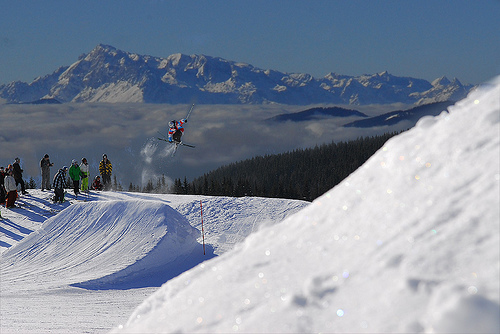

0.1252777052439261

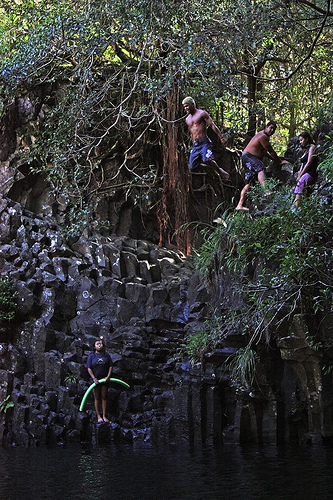

0.19594038328137828

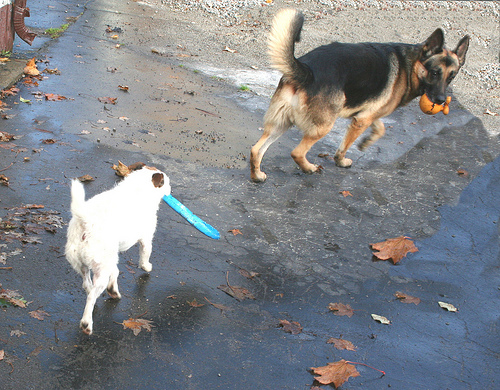

0.1734638941506098

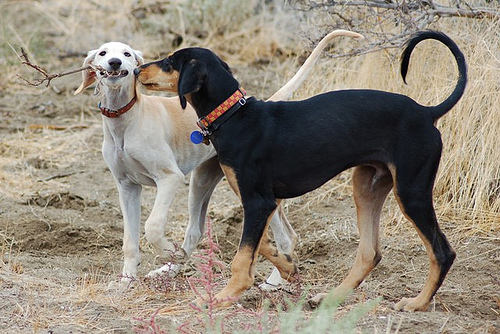

0.20717667391537037

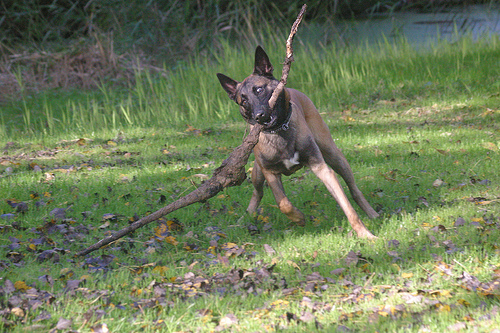

0.19567905207851044

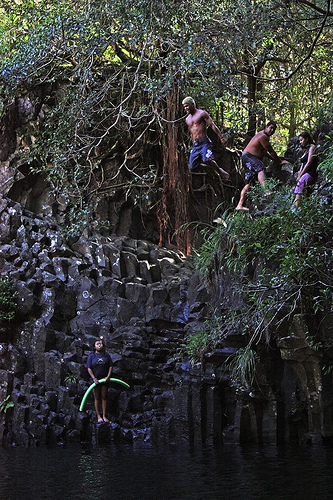

0.16554533156554652

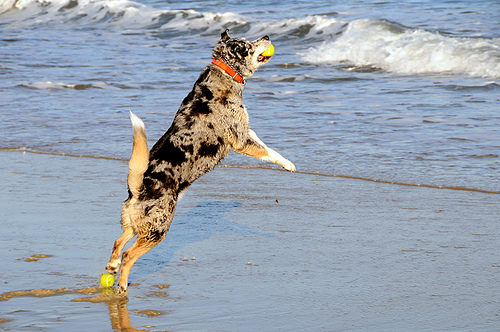

In [112]:
for i in uniq_query[:20]:
    get_inferens(i)
    

0.20630284825884782

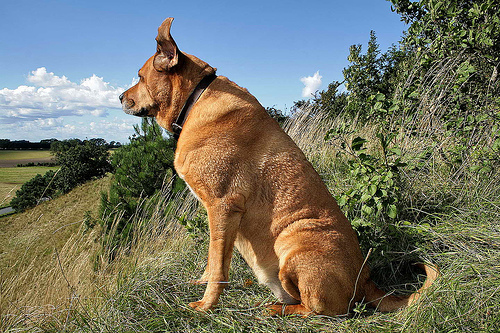

In [113]:
get_inferens('dog')

0.1276839717675925

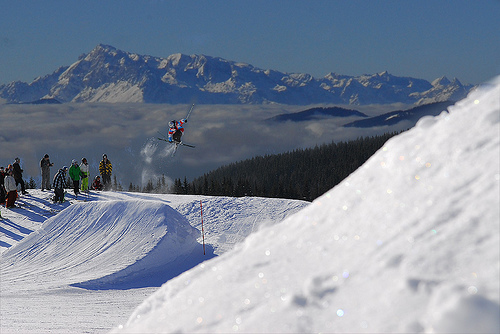

In [114]:
get_inferens('man')

0.12464890742861784

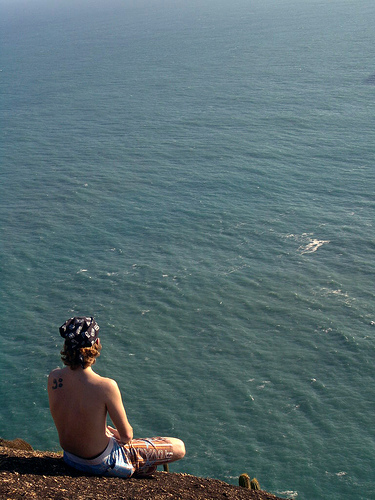

In [115]:
get_inferens('sky')

0.11654454239371453

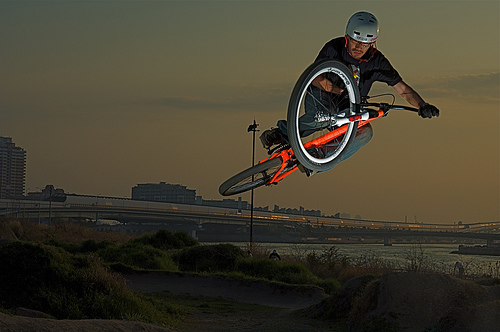

In [116]:
get_inferens('car')

0.13154471350494532

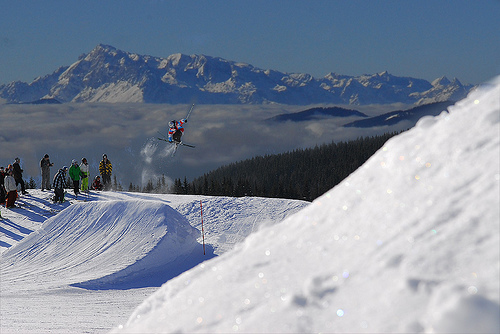

In [117]:
get_inferens('snow')

## 8. Выводы

- Jupyter Notebook открыт
- Весь код выполняется без ошибок
- Ячейки с кодом расположены в порядке исполнения
- Исследовательский анализ данных выполнен
- Проверены экспертные оценки и краудсорсинговые оценки
- Из датасета исключены те объекты, которые выходят за рамки юридических ограничений
- Изображения векторизованы
- Текстовые запросы векторизованы
- Данные корректно разбиты на тренировочную и тестовую выборки
- Предложена метрика качества работы модели
- Предложена модель схожести изображений и текстового запроса
- Модель обучена
- По итогам обучения модели сделаны выводы
- Проведено тестирование работы модели
- По итогам тестирования визуально сравнили качество поиска

* Лучшая модель - CatBoostRegressor
* МАЕ - 0.11
* Визуально кажется, что итоговая модель хорошо справляется с поиском картинки по одному слову
* Проект по созданию сервиса поиска фотографий по текстовому описанию практически осуществим, при увиличении числа картинок и описаний качество модели значительно вырастет